In [1]:
# ------------------------ # 
import sys
sys.path.insert(1, '../')
# ------------------------ # 

import os

import tensorflow as tf
import numpy as np

from matplotlib import pyplot as plt

from VQGAN.models import *
from VQGAN.utils import *
from VQGAN.data import *

import skimage.io as io
from skimage.transform import resize

In [2]:
vq_gan = VQGAN(input_dim=256,
                   embedding_dim=256,
                   num_embeddings=2048,
                   input_channels=3,
                   output_channels=3,
                   factor=4,    # 4 = 16x16, 5 = 8x8
                   filters=64   # 64
                  )

In [3]:
vq_gan.vq_vae.load_weights("./weights/run_5_z2048_vqvae.h5")

# Convert Annotations to Numpy

In [4]:
# ANNOTATION_DIR = "/home/simon/Documents/Programming/Project3/VQGAN_Annotations/cleaned_annotations"
# annotations = [ f.split(".")[0] for f in os.listdir(ANNOTATION_DIR)]

In [5]:
# OUT_DIR = "/home/simon/Documents/Programming/Project3/annotations"

In [6]:
# for file in annotations:
    
#     fname = os.path.join(ANNOTATION_DIR, file + ".txt")
    
#     with open(fname, "r") as f:
#         lines = f.readlines()
        
#     for line in lines:
#         line = line.strip()
        
#         n, text = line.split(": ")
        
#         fname = os.path.join(OUT_DIR, file.split(".")[0] + f"_{n}.npy")
        
#         np.save(fname, np.array(text))     

In [247]:
IMG_DIR = "/home/simon/Documents/Programming/Data/iec_1024/train_data"

In [248]:
files = os.listdir(IMG_DIR)

In [249]:
len(files)

11588

# Get Features (z)

In [12]:
for i, fname in enumerate(files):
    
    print(i+1, "of", len(files), end="\r")
    
    image = io.imread(os.path.join(IMG_DIR, fname))
    image = resize(image, (256, 256))
            
    # Preprocess
    x = (2*image - 1)[np.newaxis, ...]
    
    x_pred, z_q, z_e, loss_latent = vq_gan.vq_vae(x)
    
    codes = vq_gan.quantizer(z_e)[0]
    
    
    image_pred = ((x_pred + 1) / 2)[0]
    
    canvas = (np.hstack([image, image_pred]).clip(0, 1)*255.).astype("uint8")
    
#     # Save
#     out_fname = os.path.join("./representations/test_features", fname.split(".")[0] + ".npy")
#     np.save(out_fname, z_e)
    
#     out_fname = os.path.join("./representations/test_codes", fname.split(".")[0] + ".npy")
#     np.save(out_fname, codes)
    
#     out_fname = os.path.join("./representations/test_recons", fname)
#     io.imsave(out_fname, canvas)


    #io.imsave(f"/home/simon/Desktop/Project3/FID/REAL/{fname}", (image.clip(0, 1)*255.).astype("uint8"))
    
    #io.imsave(f"/home/simon/Desktop/Project3/FID/VQGAN/{fname}", (image_pred.numpy().clip(0, 1)*255.).astype("uint8"))
    
    #break

print("done.")

done. of 11588


# Analysing the Codes

In [250]:
files = os.listdir("./representations/train_codes")

In [251]:
code_counts = { i: 0 for i in range(2048)}

for f, file in enumerate(files):
    
    fname = os.path.join("./representations/train_codes", file)
    
    code = np.load(fname)[0]
    
    bins, counts = np.unique(code, return_counts=True)
    
    for i in range(len(bins)):
        
        code_counts[bins[i]] += counts[i]
    
                
    print(f+1, "of", len(files), end="\r")
    #break

In [252]:
counts = np.array(list(code_counts.items()))
mask = counts[:, 1] > 0
data = counts[mask]
sum(mask)
bins, tally = data[:, 0], data[:, 1]

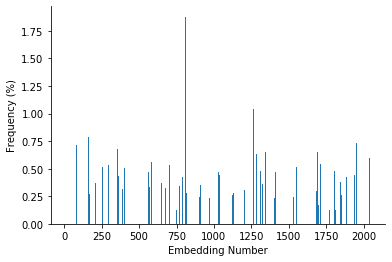

In [253]:
plt.bar(bins, tally / tally.sum() * 100, width=1.2)
plt.xlabel("Embedding Number")
plt.ylabel("Frequency (%)")

ax = plt.gca()
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)
plt.show()

In [254]:
top_10 = sorted(data, key=lambda x: x[1], reverse=True) #[0:10]

In [255]:
from skimage.transform import resize

In [256]:
out_group = set(range(2048)) - set(data[:, 0])
out_group =  np.array(list(out_group))

In [257]:
top_100 = sorted(data, key=lambda x: x[1], reverse=True)

In [267]:
imgs = []
for t in top_100[0:25]:
    
    q = (np.ones((1, 4, 4))*t[0]).astype("int")
    #q = np.random.choice(data[:, 0], size=(1, 4, 4))
    #q = np.random.choice(out_group, size=(1, 4, 4))
    
    z_q = vq_gan.quantizer.get_embeddings(q)
    
    img = vq_gan.decoder(z_q).numpy()[0] #.clip(0,1)[0]
    
    img = deprocess(img)
    
    #img = resize(img[0], (64, 64), order=0)
    
    imgs.append(img)

In [268]:
len(imgs)

25

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


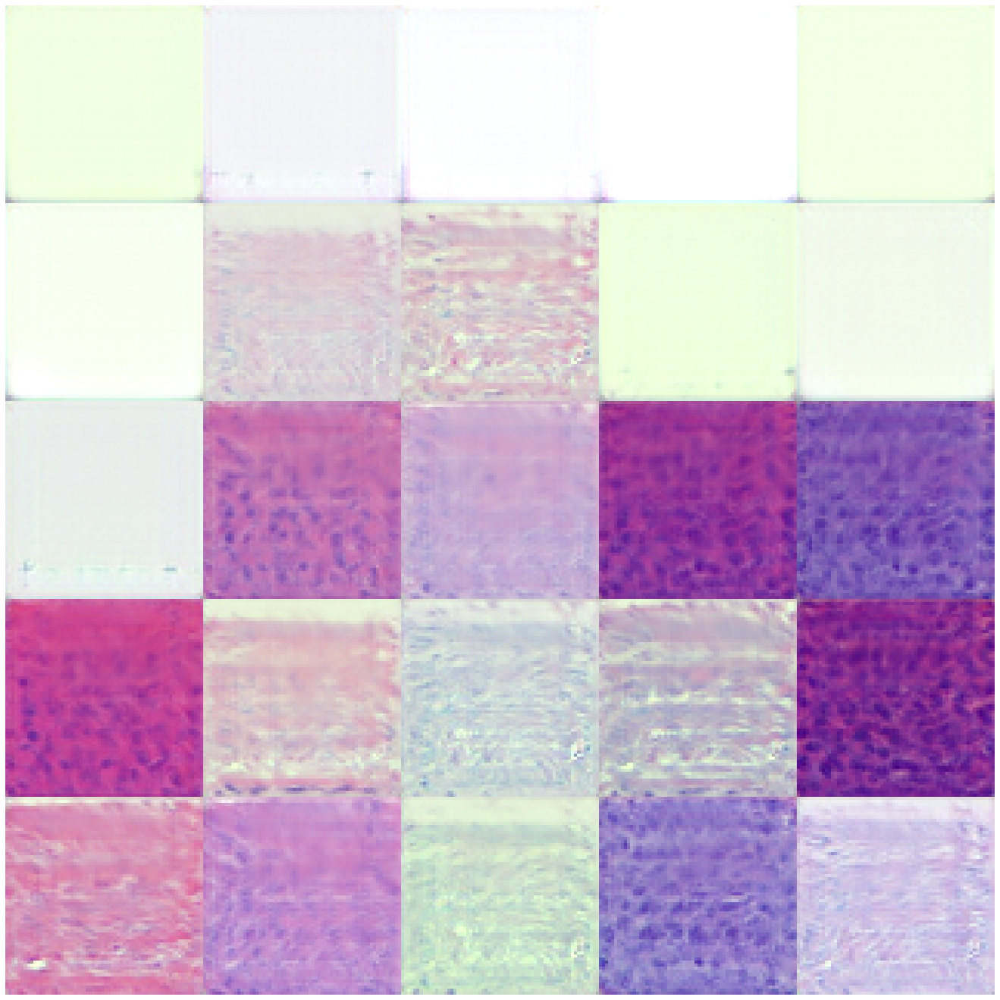

In [269]:
rows = []
for i in range(5):
    
    row = imgs[i*5:i*5+5]
    
    rows.append(np.hstack(row))
canvas = np.vstack(rows)

plt.figure(figsize=(24, 24))
plt.imshow(canvas)
plt.axis("off")
plt.show()

### Do the same for Autoencoder ones...

In [33]:
DIR = "/home/simon/Desktop/Project3/FID/ae_latents"

In [34]:
files = os.listdir(DIR)

In [44]:
ae_code_counts = { i: 0 for i in range(2048)}

for f, file in enumerate(files):
    
    fname = os.path.join(DIR, file)
    
    z_e = np.load(fname)
    
    
    code = vq_gan.quantizer(z_e)[0]
    

    bins, counts = np.unique(code, return_counts=True)
    
    for i in range(len(bins)):
        
        ae_code_counts[bins[i]] += counts[i]
    
    #break
    print(f+1, "of", len(files), end="\r")

In [47]:
counts = np.array(list(ae_code_counts.items()))
mask = counts[:, 1] > 0
ae_data = counts[mask]
print(sum(mask))
bins, tally = ae_data[:, 0], ae_data[:, 1]

380


In [51]:
inter = set(ae_data[:, 0]).intersection(data[:, 0])

In [53]:
len(inter)

282

# Nearest-K Features

In [159]:
DIR = "./representations/train_codes"

In [160]:
files = os.listdir(DIR)

In [234]:
fname = os.path.join(DIR, files[894])

In [235]:
feat = np.load(fname)

In [240]:
feat.shape

(1, 16, 16)

In [241]:
fname

'./representations/train_codes/19H19938_1B_IEC_22_lr.npy'

In [238]:
z_q = vq_gan.quantizer.get_embeddings(feat)
img = vq_gan.decoder(z_q).numpy()# .clip(0, 1)
img = deprocess(img)
IMGS.append(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


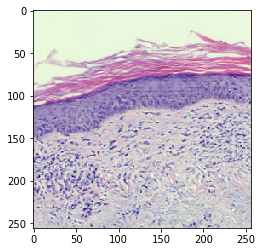

In [239]:
plt.imshow(IMGS[-1][0])
plt.show()

In [242]:
IMGS = []

In [243]:
x = z_q
# Flatten input except for last dimension.
flat_inputs = K.reshape(x, (-1, vq_gan.quantizer.embedding_dim))

In [244]:
# Calculate distances of input to embedding vectors.
distances = (K.sum(flat_inputs**2, axis=1, keepdims=True)
             - 2 * K.dot(flat_inputs, vq_gan.quantizer._w)
             + K.sum(vq_gan.quantizer._w ** 2, axis=0, keepdims=True))

In [245]:
distances = np.copy(distances)

In [270]:
for i in range(4):
    # Calc distances
    indices = K.argmax(-distances, axis=1)

    # Generate Images
    z_q = vq_gan.quantizer.get_embeddings(indices.numpy().reshape(1, 16, 16))
    img = vq_gan.decoder(z_q).numpy() #.clip(0, 1)
    img = deprocess(img)
    IMGS.append(img)
    
    # Update distances with indices
    distances[:,indices] = np.inf
    
#     plt.figure(figsize=(8, 8))
#     plt.imshow(IMGS[-1][0])
#     plt.axis("off")
#     plt.show()

### ALL IMAGES

In [ ]:
DIR = "./representations/train_codes"

In [ ]:
files = os.listdir(DIR)

In [ ]:
code_counts = {i: 0 for i in range(2048)}

for f, file in enumerate(files):
    
    fname = os.path.join(DIR, file)
    
    feat = np.load(fname)
    
    
    x = z_q
    # Flatten input except for last dimension.
    flat_inputs = K.reshape(x, (-1, vq_gan.quantizer.embedding_dim))

    # Calculate distances of input to embedding vectors.
    distances = (K.sum(flat_inputs**2, axis=1, keepdims=True)
             - 2 * K.dot(flat_inputs, vq_gan.quantizer._w)
             + K.sum(vq_gan.quantizer._w ** 2, axis=0, keepdims=True))
    
    distances = np.copy(distances)
    
    for i in range(4):
        # Calc distances
        indices = K.argmax(-distances, axis=1)

        # Generate Images
        z_q = vq_gan.quantizer.get_embeddings(indices.numpy().reshape(1, 16, 16))
        img = vq_gan.decoder(z_q).numpy() #.clip(0, 1)
        img = deprocess(img)
        IMGS.append(img)

        # Update distances with indices
        distances[:,indices] = np.inf
        
        
        # Tally
        bins, counts = np.unique(indices.numpy(), return_counts=True)
        
        for j in range(len(bins)):
            
            code_counts[bins[j]] += counts[j]
        
    
    #break
    
    print(f+1, "of", len(files), end="\r")

In [ ]:
counts = np.array(list(code_counts.items()))
mask = counts[:, 1] > 0
data = counts[mask]
sum(mask)
bins, tally = data[:, 0], data[:, 1]

# Interpolations

In [10]:
C = "basket_para"
feats = np.load(f"./{C}_interp.npy")
#feats = np.load("/home/simon/Documents/Programming/Project3/VQGAN/interpolation_x8_x9.npy")

In [11]:
# for feat in feats:
    
#     img = np.mean(feat, axis=-1)
    
#     plt.imshow(img)
#     plt.show()

In [12]:

for i, feat in enumerate(feats):
    
    
    print(i, "of", len(feats))
    
    imgs = []
    for inter_f in feat:
    
        encoding_indices, z_q, z_e, latent_loss = vq_gan.quantizer(inter_f[np.newaxis])

        out = vq_gan.decoder(z_q)

        img = deprocess(out)[0].numpy().clip(0, 1)

        imgs.append(img)
        
        
    canvas = np.hstack(imgs)
    
    #plt.imshow(canvas)
    #plt.show()
    plt.imsave(f"./{C}_interp_{i}.jpg", canvas)
    
    print(canvas.shape)

0 of 5
(256, 28160, 3)
1 of 5
(256, 28160, 3)
2 of 5
(256, 28160, 3)
3 of 5
(256, 28160, 3)
4 of 5
(256, 28160, 3)


In [36]:
feats = np.load("/home/simon/Desktop/Project3/interpolation_x10_x11.npy")

In [37]:
imgs = []
for inter_f in feats:

    encoding_indices, z_q, z_e, latent_loss = vq_gan.quantizer(inter_f[np.newaxis])

    out = vq_gan.decoder(z_q)

    img = deprocess(out)[0].numpy().clip(0, 1)

    imgs.append(img)


canvas = np.hstack(imgs)

plt.imsave(f"./interpolation_5.jpg", canvas)

# AE Recons

In [22]:
x_recon = np.load("/home/simon/Desktop/Project3/representations/ae_validation_recons/ae_recon.npy")
x_real = np.load("/home/simon/Desktop/Project3/representations/ae_validation_recons/ae_real.npy")


# x_real = np.load("/home/simon/Desktop/Project3/representations/ae_validation_recons/alae_real_ft.npy")
# x_recon = np.load("/home/simon/Desktop/Project3/representations/ae_validation_recons/alae_recon_ft.npy")
# x_rand = np.load("/home/simon/Desktop/Project3/representations/ae_validation_recons/alae_rand_ft.npy")

In [25]:
for x in x_recon[0:20]:
    
    print(x.shape)
    
    break

(16, 16, 256)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


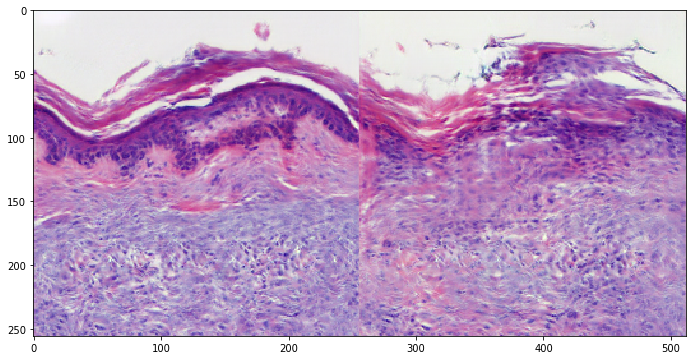

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


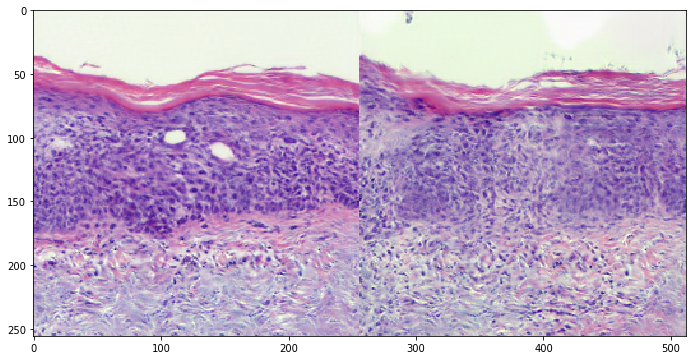

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


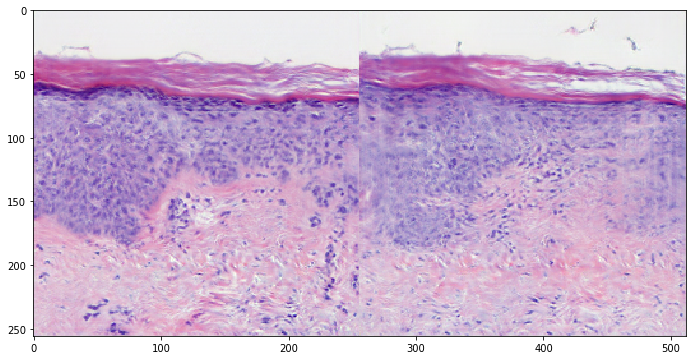

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


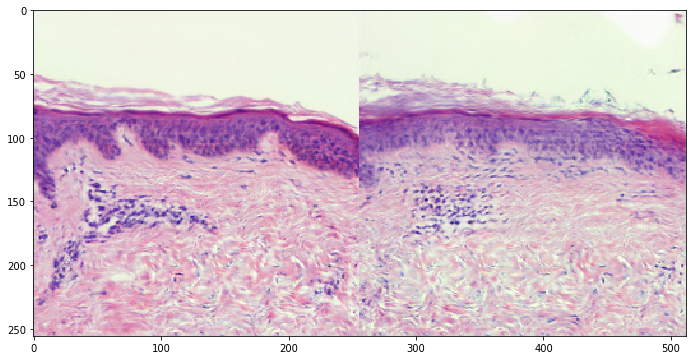

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


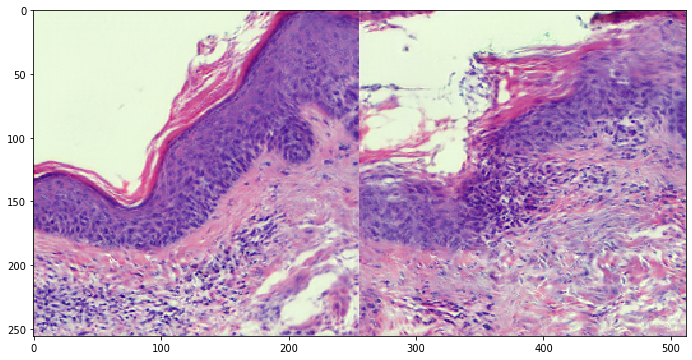

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


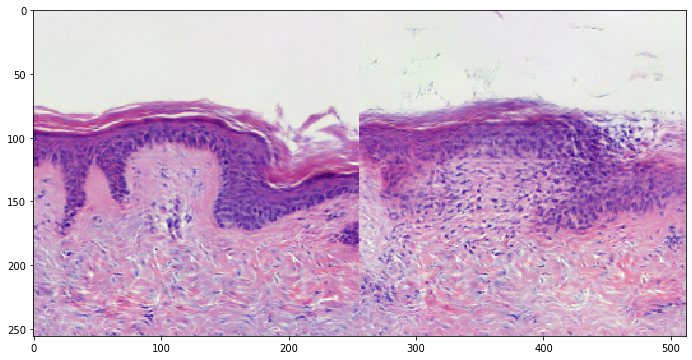

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


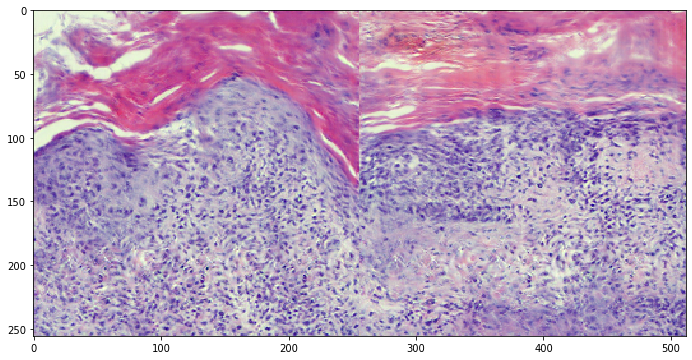

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


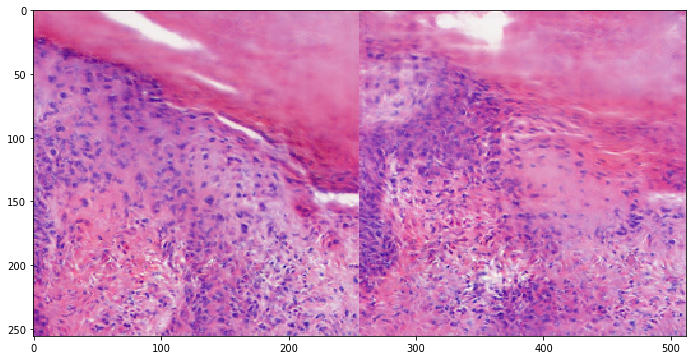

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


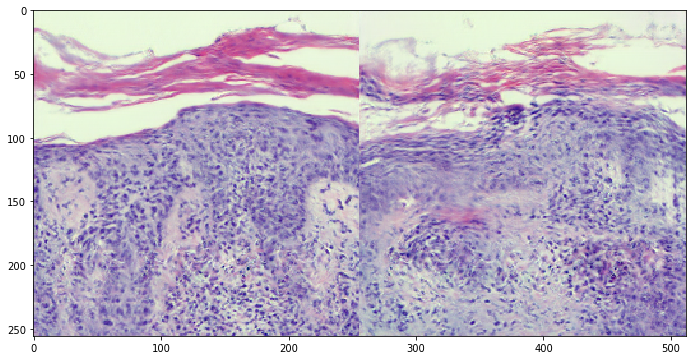

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


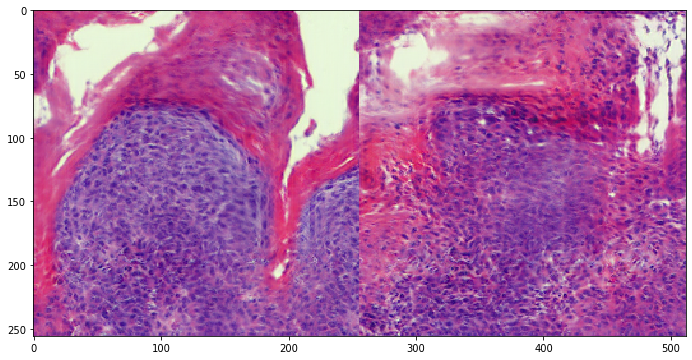

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


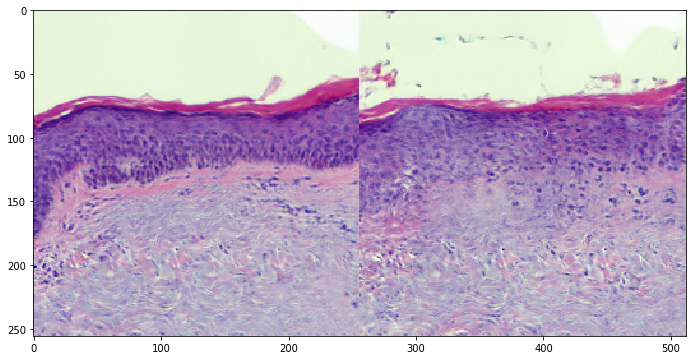

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


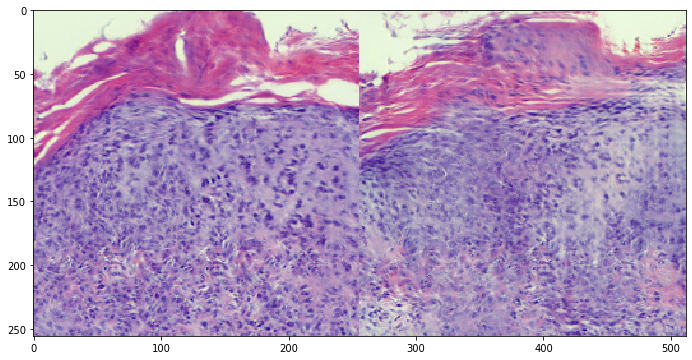

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


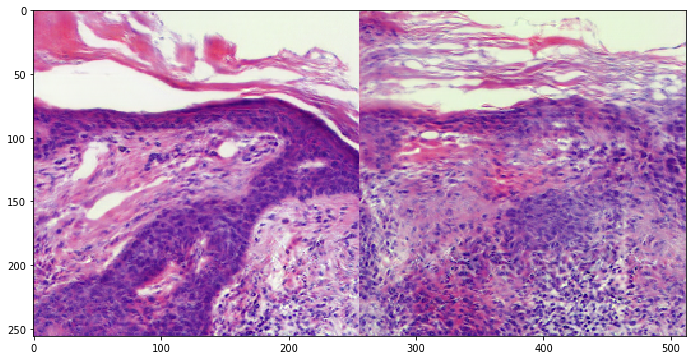

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


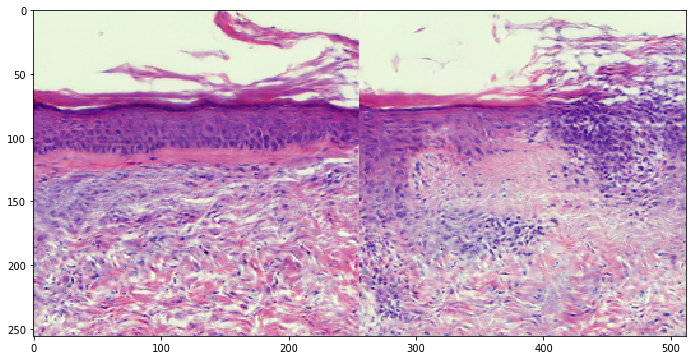

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


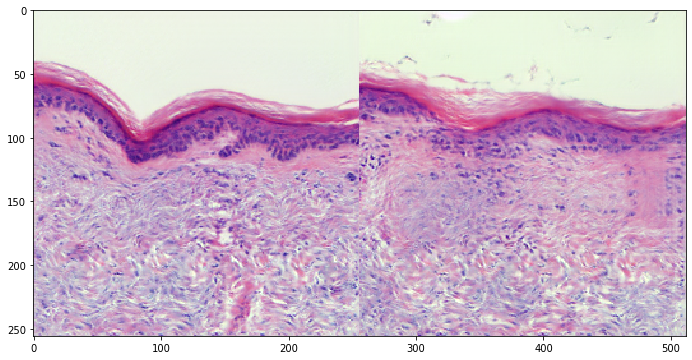

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


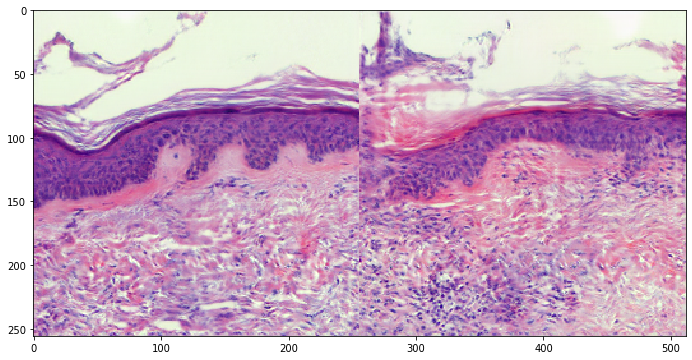

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


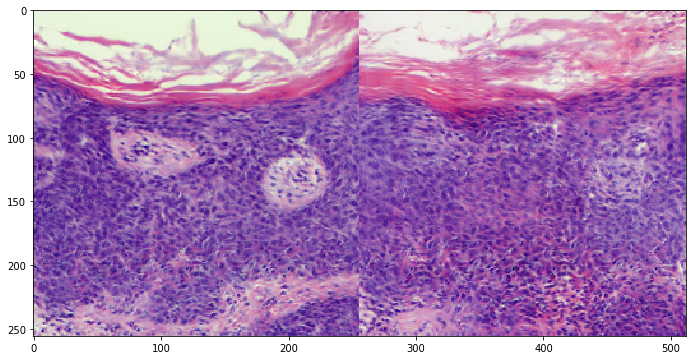

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


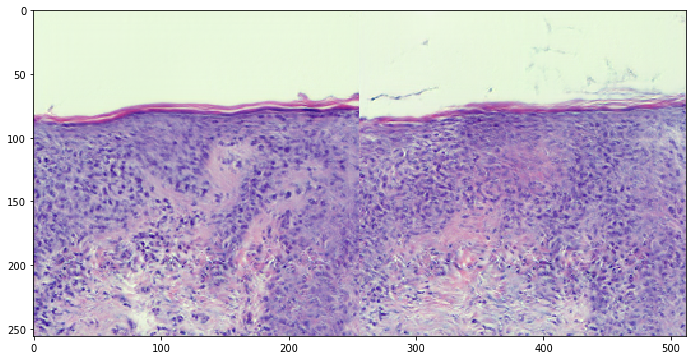

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


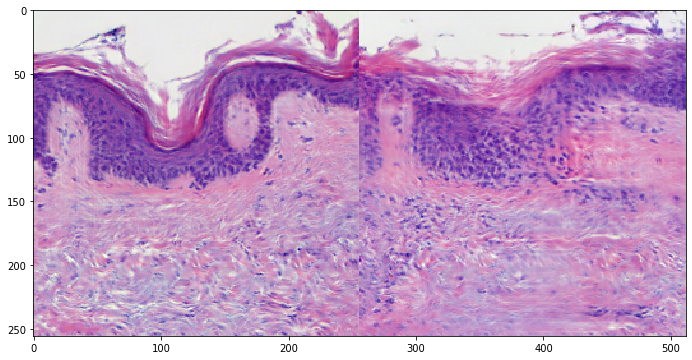

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


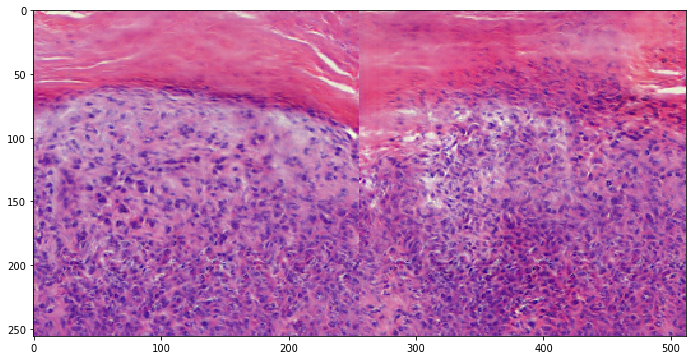

In [12]:
for feat1, feat2 in zip(x_real[0:20], x_recon[0:20]):
    

    encoding_indices, z_q, z_e, latent_loss = vq_gan.quantizer(feat1[np.newaxis])
    
    out = vq_gan.decoder(z_q)
    
    real = deprocess(out)[0]
    
    encoding_indices, z_q, z_e, latent_loss = vq_gan.quantizer(feat2[np.newaxis])
    
    out = vq_gan.decoder(z_q)
    
    recon = deprocess(out)[0]
    
    img = np.hstack([real, recon])
    plt.figure(figsize=(12, 6))
    plt.imshow(img)
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


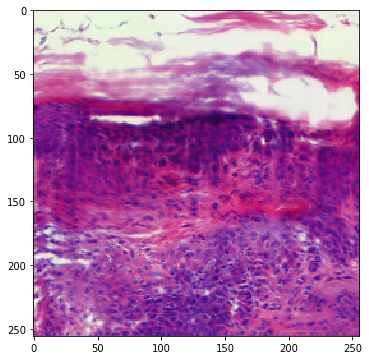

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


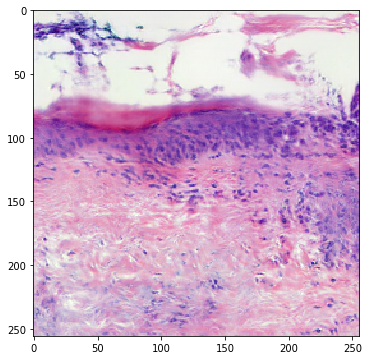

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


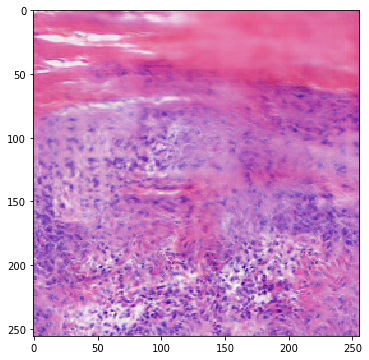

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


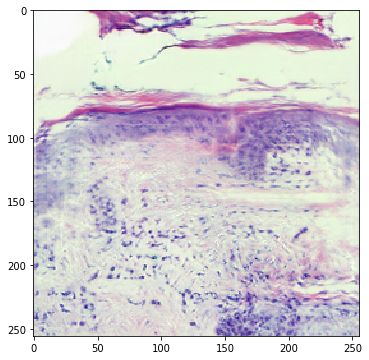

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


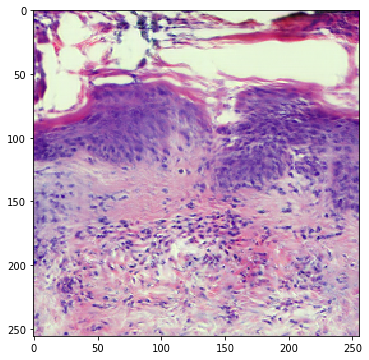

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


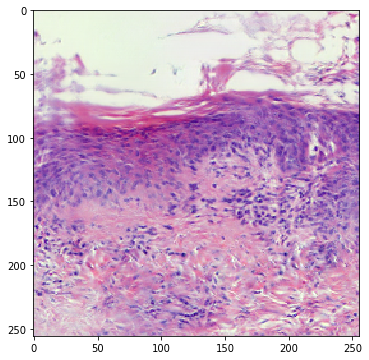

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


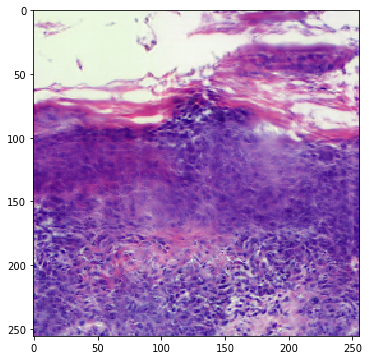

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


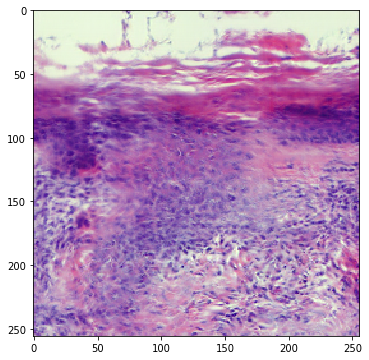

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


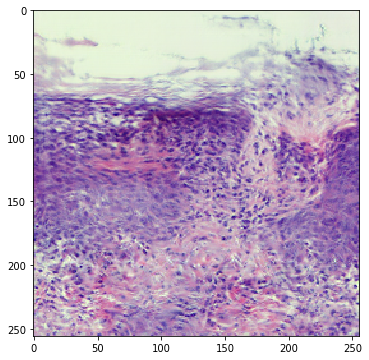

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


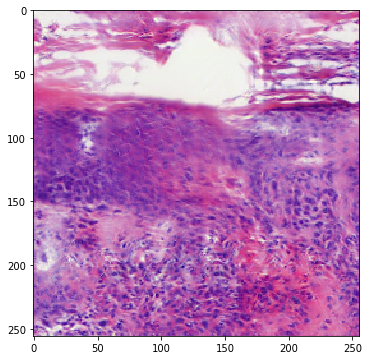

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


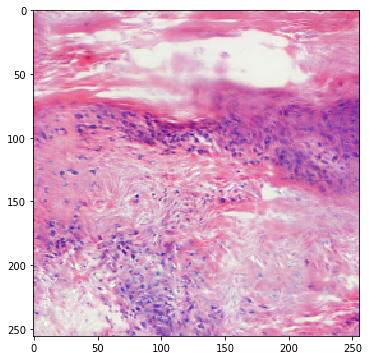

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


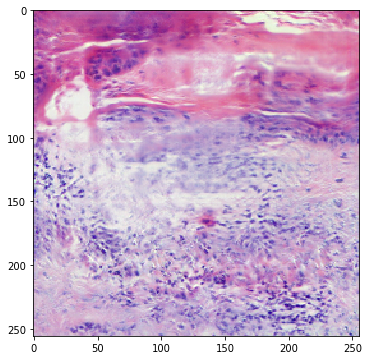

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


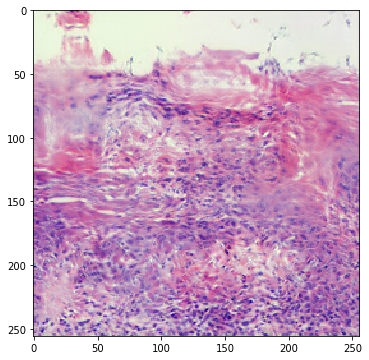

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


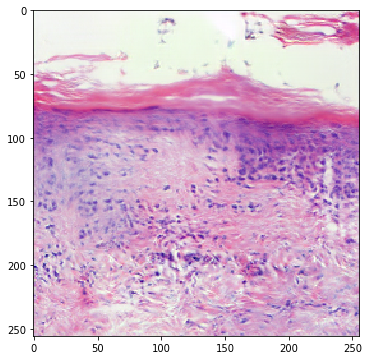

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


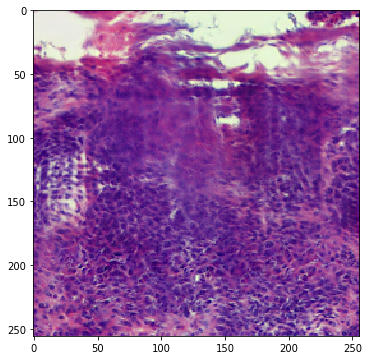

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


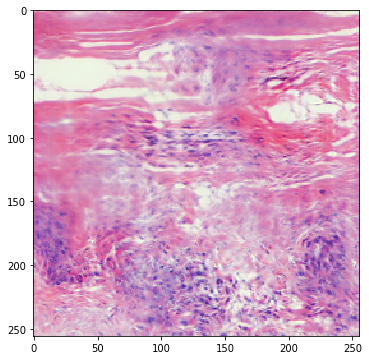

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


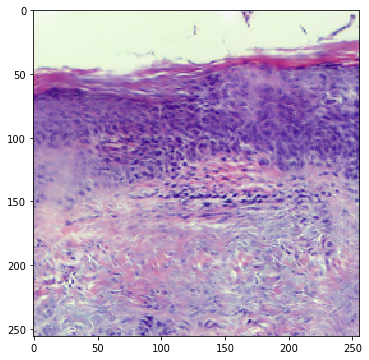

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


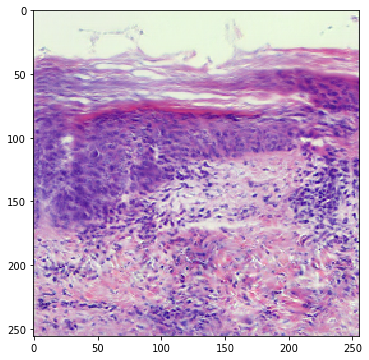

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


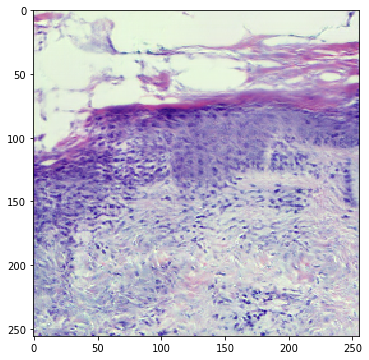

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


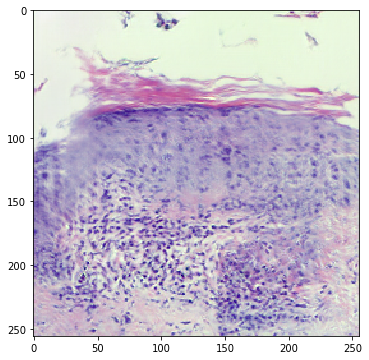

In [13]:
for feat1 in x_rand[0:20]:
    

    encoding_indices, z_q, z_e, latent_loss = vq_gan.quantizer(feat1[np.newaxis])
    
    out = vq_gan.decoder(z_q)
    
    real = deprocess(out)[0]
    
    plt.figure(figsize=(12, 6))
    plt.imshow(real)
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


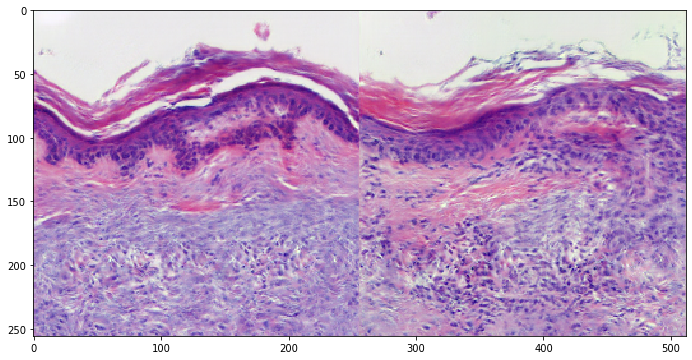

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


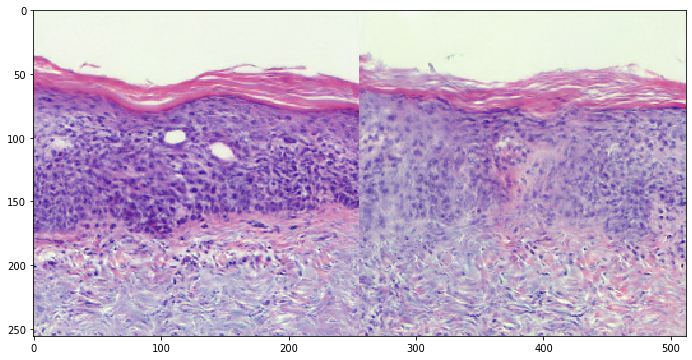

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


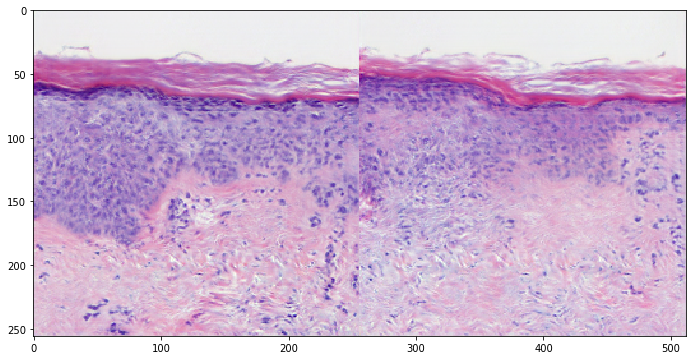

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


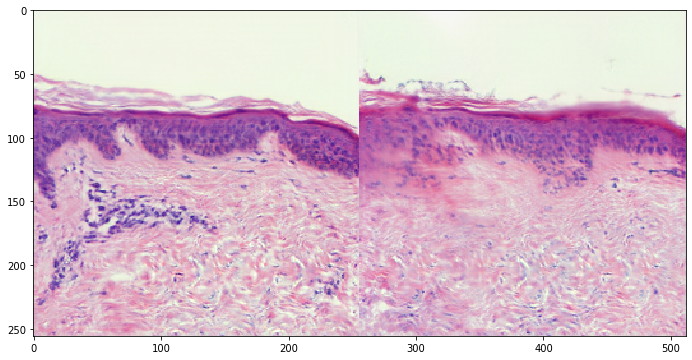

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


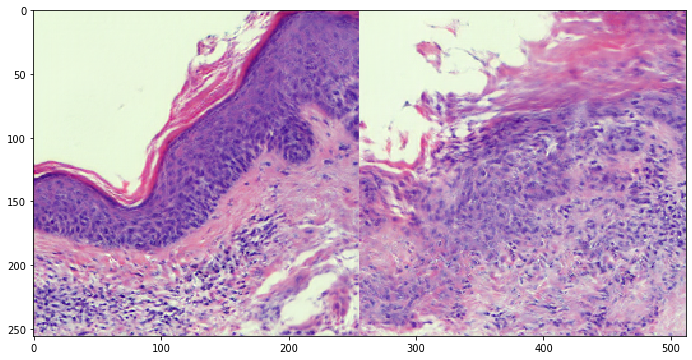

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


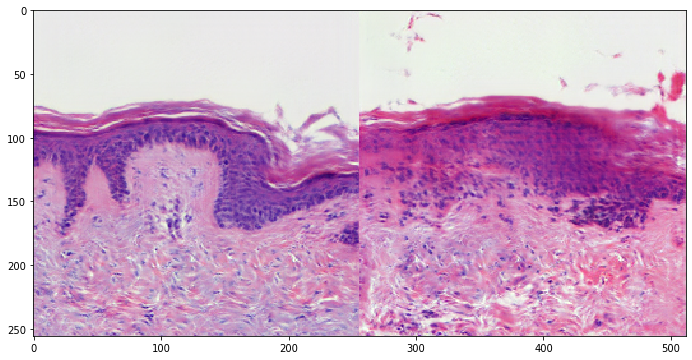

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


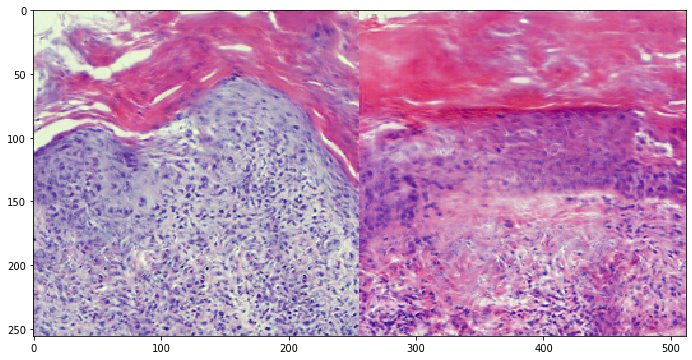

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


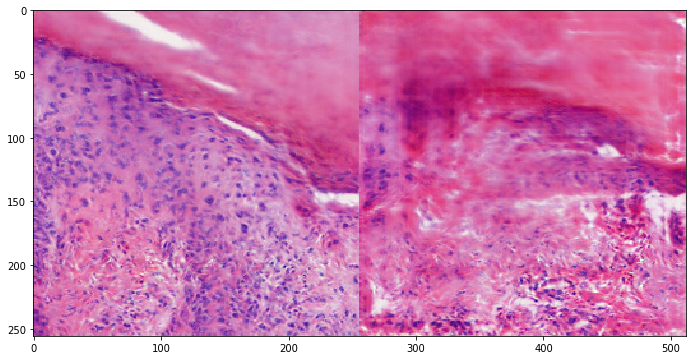

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


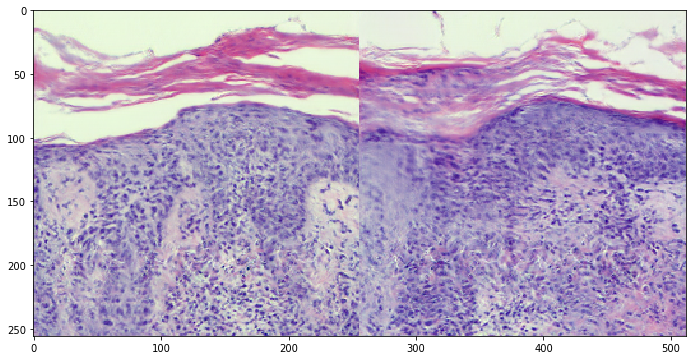

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


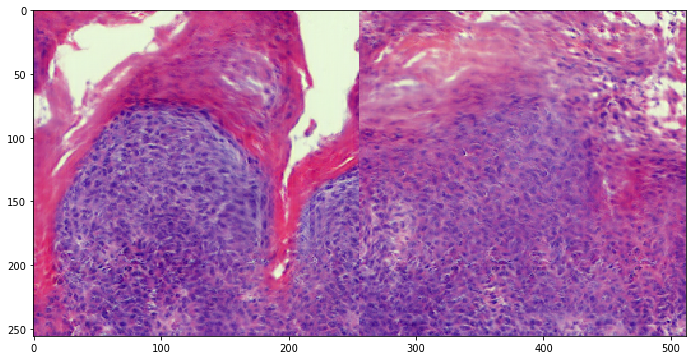

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


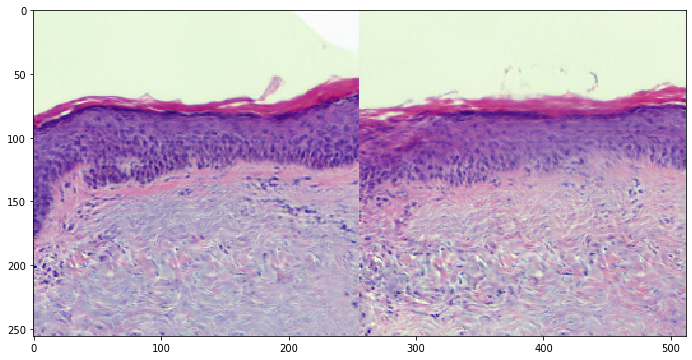

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


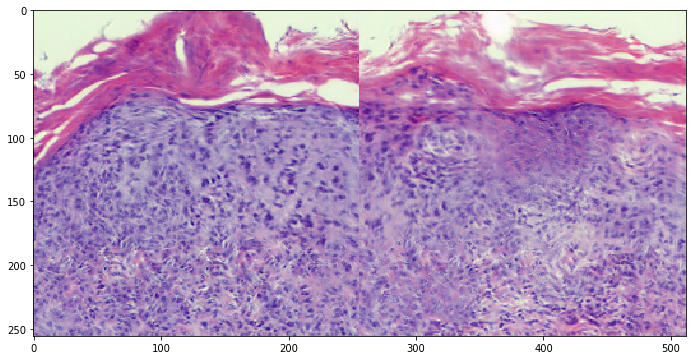

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


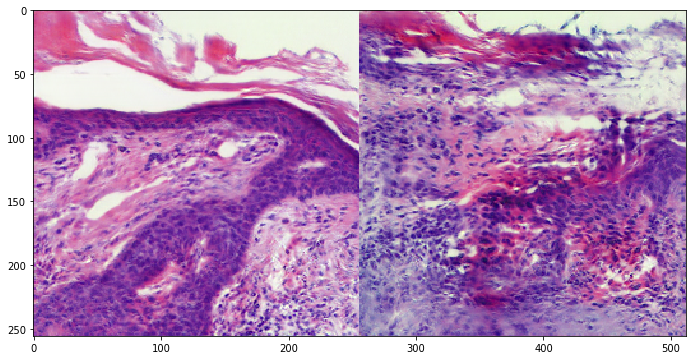

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


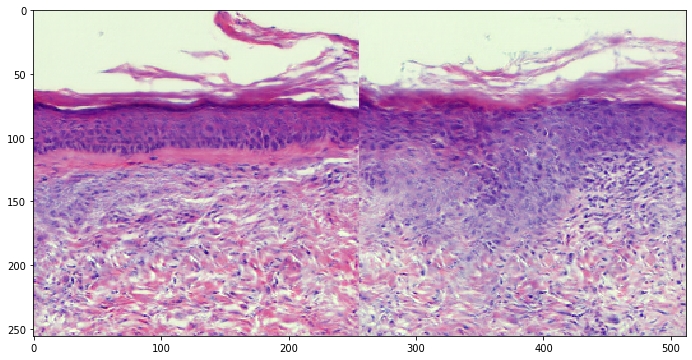

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


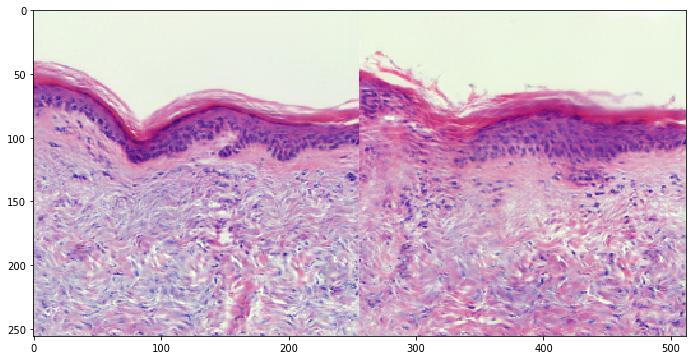

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


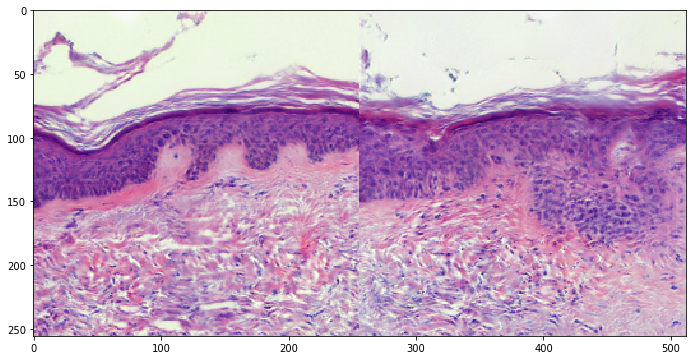

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


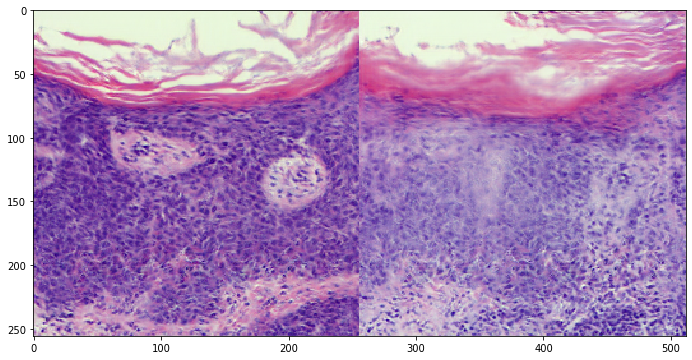

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


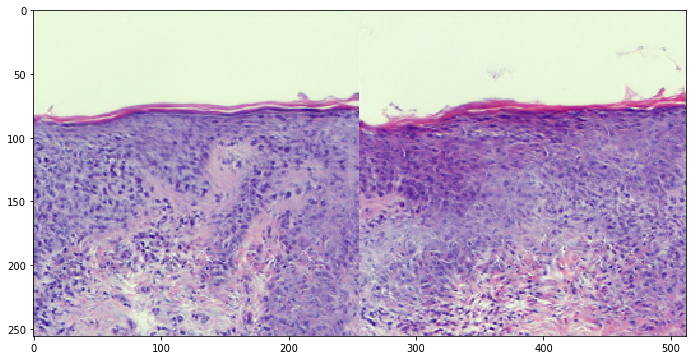

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


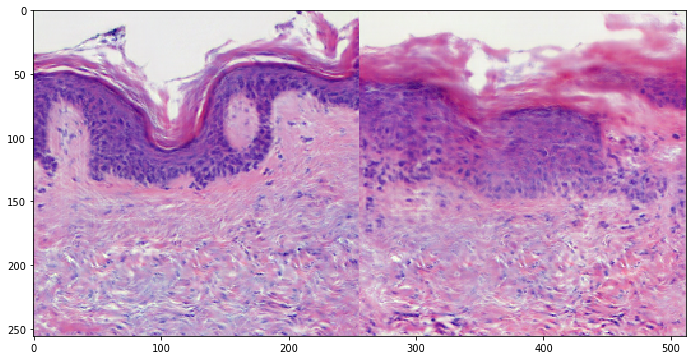

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


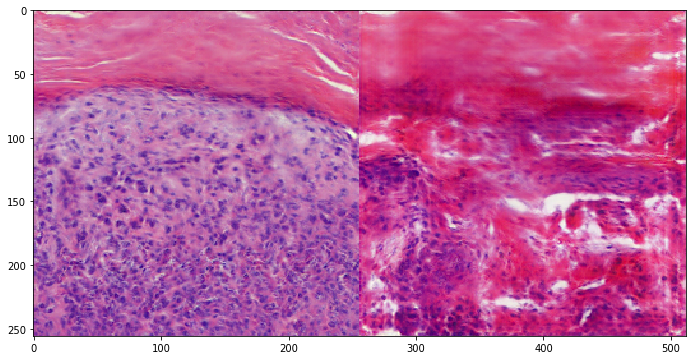

In [11]:
for feat1, feat2 in zip(x_real[0:20], x_recon[0:20]):
    

    encoding_indices, z_q, z_e, latent_loss = vq_gan.quantizer(feat1[np.newaxis])
    
    out = vq_gan.decoder(z_q)
    
    real = deprocess(out)[0]
    
    encoding_indices, z_q, z_e, latent_loss = vq_gan.quantizer(feat2[np.newaxis])
    
    out = vq_gan.decoder(z_q)
    
    recon = deprocess(out)[0]
    
    img = np.hstack([real, recon])
    plt.figure(figsize=(12, 6))
    plt.imshow(img)
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


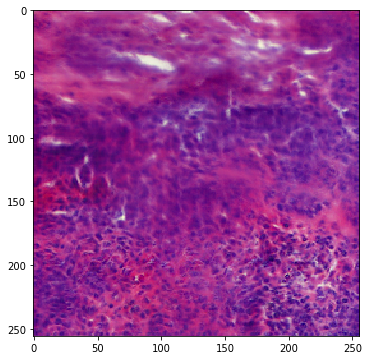

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


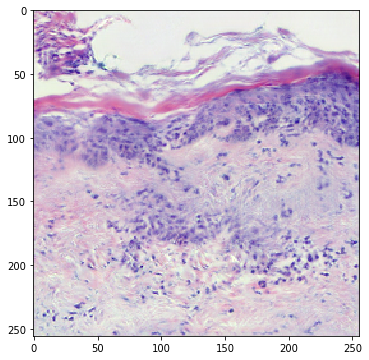

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


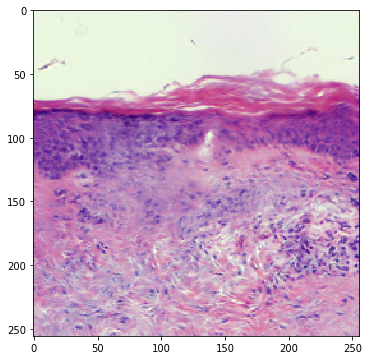

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


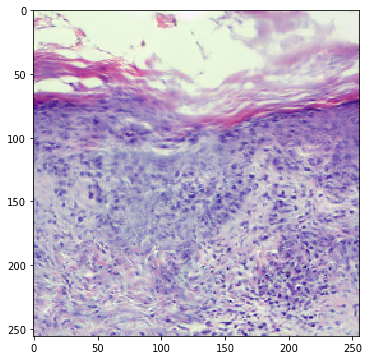

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


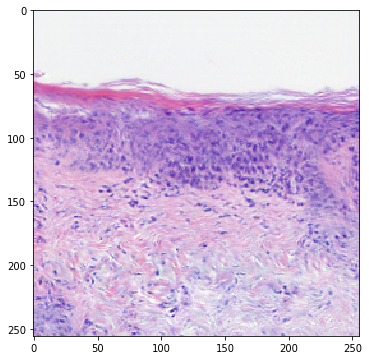

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


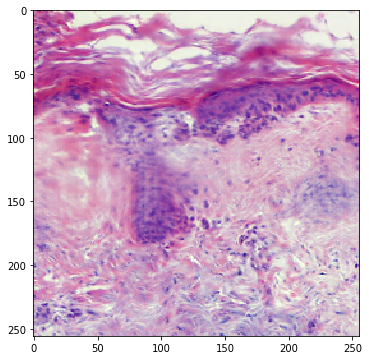

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


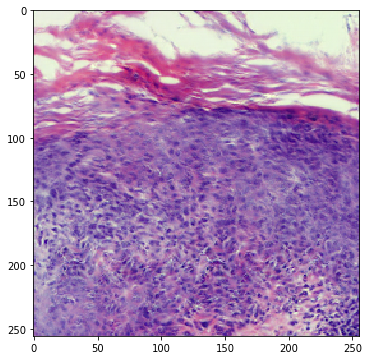

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


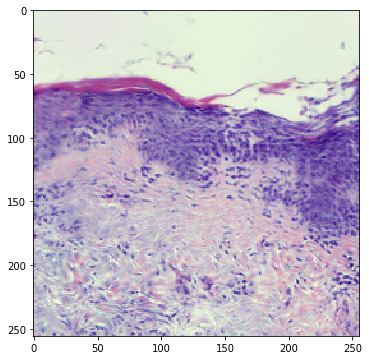

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


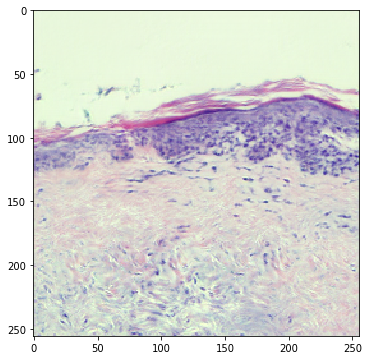

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


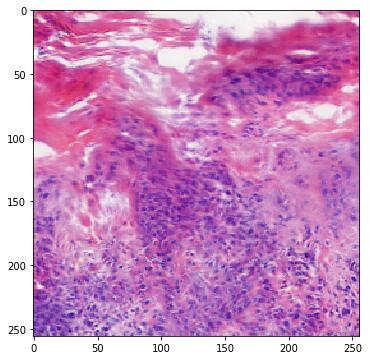

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


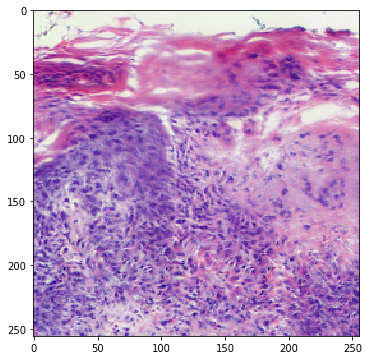

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


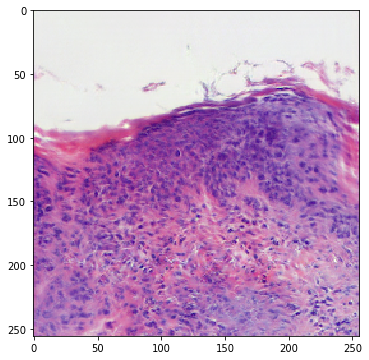

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


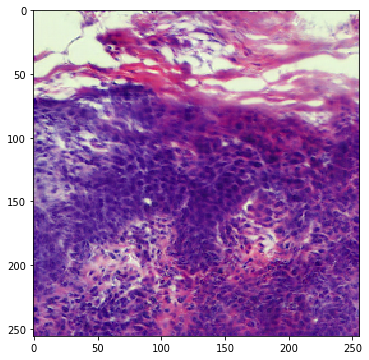

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


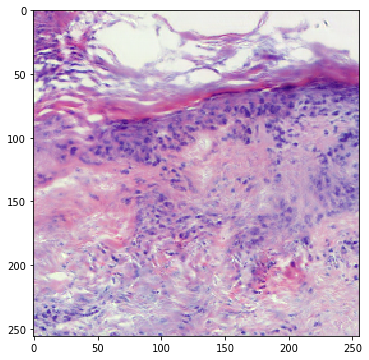

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


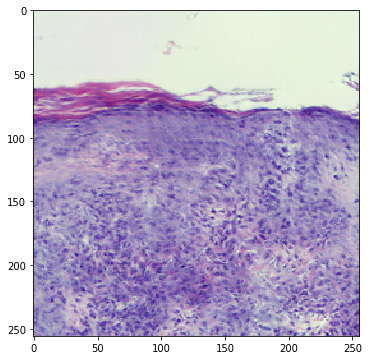

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


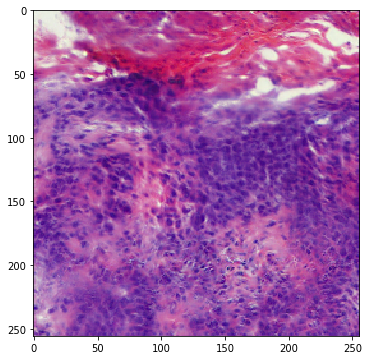

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


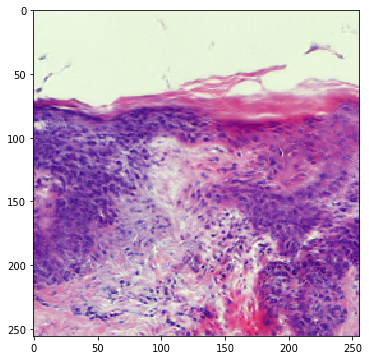

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


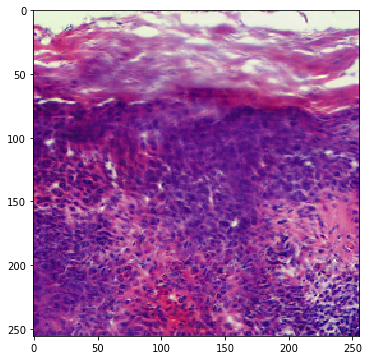

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


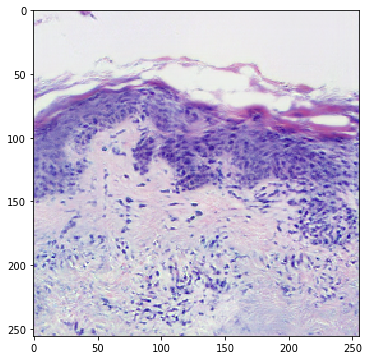

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


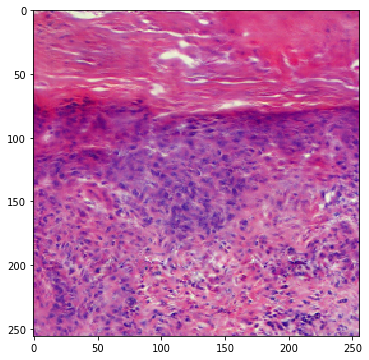

In [12]:
for feat1 in x_rand[0:20]:
    

    encoding_indices, z_q, z_e, latent_loss = vq_gan.quantizer(feat1[np.newaxis])
    
    out = vq_gan.decoder(z_q)
    
    real = deprocess(out)[0]
    
    plt.figure(figsize=(12, 6))
    plt.imshow(real)
    plt.show()

# Recons from Autoencoder

In [11]:
i = 0
for feat1, feat2 in zip(x_real[0:20], x_recon[0:20]):
    

    encoding_indices, z_q, z_e, latent_loss = vq_gan.quantizer(feat1[np.newaxis])
    
    out = vq_gan.decoder(z_q)
    
    real = deprocess(out)[0]
    
    encoding_indices, z_q, z_e, latent_loss = vq_gan.quantizer(feat2[np.newaxis])
    
    out = vq_gan.decoder(z_q)
    
    recon = deprocess(out)[0]
    
    img = np.hstack([real, recon])
    #plt.figure(figsize=(12, 6))
    #plt.imshow(img)
    #plt.show()
    
    
    plt.imsave(f"/home/simon/Desktop/Project3/imgs/ae_recons/ae_recon_{i}.jpg", img.clip(0, 1))
    
    i += 1

# FID Recons

In [15]:
import os

In [10]:
LATENT_DIR = "/home/simon/Desktop/Project3/FID/ae_latents"

In [11]:
OUT_DIR = "/home/simon/Desktop/Project3/FID/AUTOENCODER"

In [12]:
files = os.listdir(LATENT_DIR)

In [25]:
for i, f in enumerate(files):
    
    fname = os.path.join(LATENT_DIR, f)
    
    feat = np.load(fname)
  
    encoding_indices, z_q, z_e, latent_loss = vq_gan.quantizer(feat)
    
    out = vq_gan.decoder(z_q)
    
    real = deprocess(out)[0]
    
    img = (real.numpy().clip(0, 1)*255).astype("uint8")
    
    
    fname = os.path.join(OUT_DIR, f.split(".")[0] + ".jpg")
    
    io.imsave(fname, img)
    
    print(i, "of", len(files), end="\r")

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


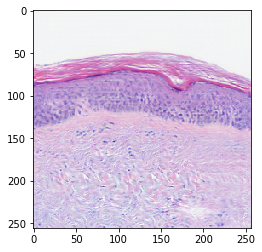

In [19]:
plt.imshow(real.numpy())

1.1155498